# Clustering

The effect of directly calculating QOL is not very good, for example, strange places like Wulai District and Shimen District can be the highest level??? It is very unreasonable, so try to see the results of using classification points. The advantages of this are:

The so-called quality of life has always been very intuitive. I think Wulai District is not good, but it does not mean that other people think Wulai District is not good. Therefore, dividing the data into different aspects and grouping them separately can give different users different experiences. 

Secondly, when calculating the scores, I referred to previous literature and my own subjective judgment to set the weights, so it involves my own values. When using cluster analysis, it adds objectivity to the analysis. For example: when calculating the quality of life, I set both divorced and unmarried as negative numbers, which is my subjective opinion.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
from datetime import datetime

In [2]:
%matplotlib inline

## Read Data

In [3]:
df = pd.read_csv('../02_data preprocessing/origin_dataset.csv', encoding='utf-8').drop(columns=['Unnamed: 0'])
df1 = pd.read_csv('../02_data preprocessing/dataset.csv', encoding='utf-8').drop(columns=['Unnamed: 0'])
df.describe()

,Year,c_pop_Population,c_ratio_Sex Ratio,c_popcal_Population Density,c_ratio_Dependency Ratio,c_ratio_Child Dependency Ratio,c_ratio_Elderly Dependency Ratio,c_ratio_Aging Index,c_pop_Population aged 0-14,c_pop_Population aged 15-64,...,Township Name_中正區,Township Name_信義區,Township Name_內湖區,Township Name_北投區,Township Name_南港區,Township Name_士林區,Township Name_大同區,Township Name_大安區,Township Name_文山區,Township Name_松山區
count,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,...,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000,7440.000000
mean,107.000000,4476.647312,96.948394,28134.557767,39.268671,16.536926,22.731668,157.666535,574.290457,3230.944624,...,0.022849,0.008065,0.006048,0.024194,0.006720,0.025538,0.007392,0.010081,0.008065,0.013441
std,1.414309,2583.315356,10.763770,23292.577458,8.093970,5.094264,7.648138,109.200979,448.147877,1865.126411,...,0.149433,0.089446,0.077541,0.153660,0.081708,0.157762,0.085667,0.099902,0.089446,0.115161
min,105.000000,139.000000,71.680000,2.990000,19.130000,1.870000,6.940000,23.270000,2.000000,94.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,106.000000,2679.750000,90.780000,5898.100000,33.540000,13.440000,17.390000,97.722500,278.000000,1928.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,107.000000,4328.000000,94.755000,25236.555000,38.340000,15.950000,22.170000,134.770000,507.000000,3125.500000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,108.000000,5867.750000,99.400000,45298.557500,43.850000,18.572500,27.132500,184.380000,736.000000,4269.250000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,109.000000,26848.000000,169.310000,124176.320000,81.510000,43.280000,68.100000,1875.000000,5837.000000,18087.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


## EDA

Relevance of original data:

Population and three-level classification population are extremely consistent, and population and marriage are also related.

Several items of ratio are calculated from the three-level classification.

House prices are extremely correlated

The obtained standard deviation is highly correlated with q1\q3

Household size is proportional to total income

Various types of income are related to other income and education level

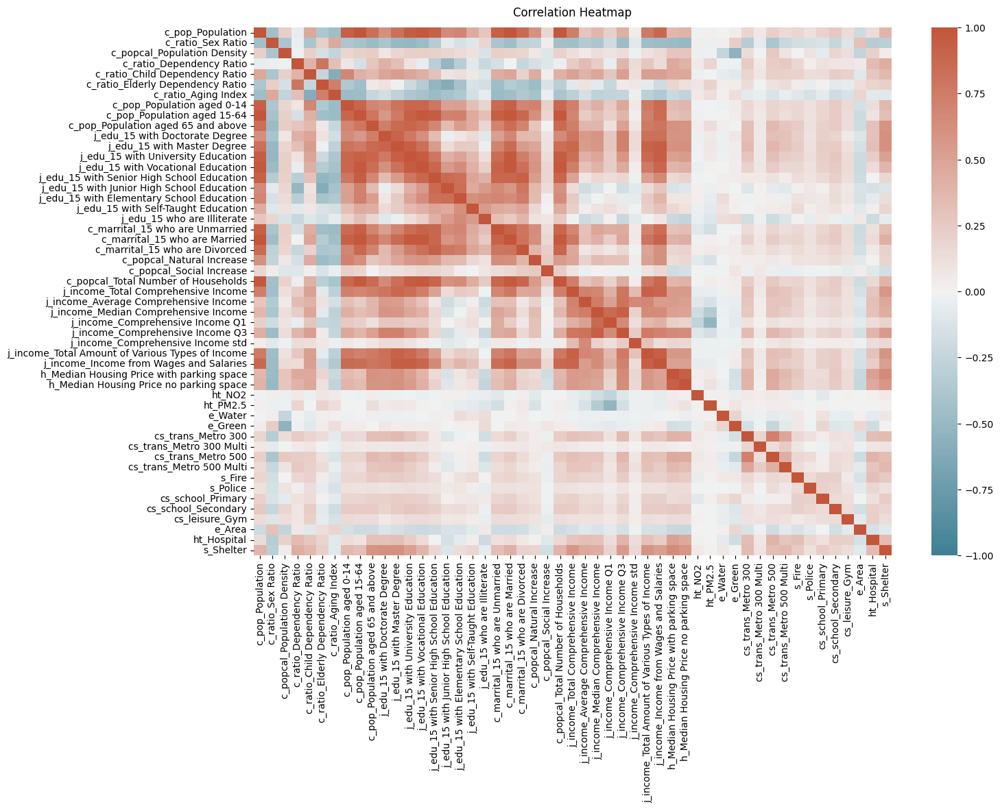

In [ ]:
plt.figure(figsize=(15, 10))

heatmap = sns.heatmap(df.iloc[:, 4:55].corr(), vmin=-1, vmax=1, annot=False, cmap=sns.diverging_palette(220, 20, as_cmap=True))

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

After normalization and normal distribution transformation

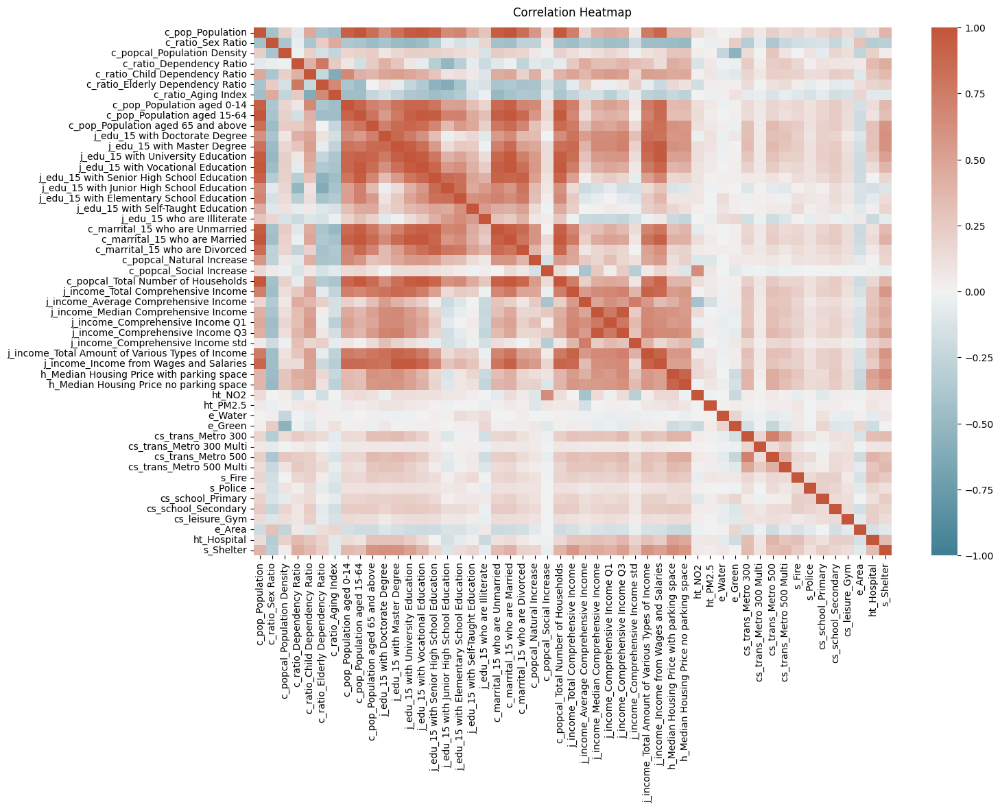

In [ ]:
plt.figure(figsize=(15, 10))

heatmap = sns.heatmap(df1.iloc[:, 4:55].corr(), vmin=-1, vmax=1, annot=False, cmap=sns.diverging_palette(220, 20, as_cmap=True))

heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':12}, pad=12);

## charts

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7440 entries, 0 to 7439
Data columns (total 96 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Year                                              7440 non-null   int64  
 1   County Name                                       7440 non-null   object 
 2   Township Name                                     7440 non-null   object 
 3   Village Name                                      7440 non-null   object 
 4   c_pop_Population                                  7440 non-null   int64  
 5   c_ratio_Sex Ratio                                 7440 non-null   float64
 6   c_popcal_Population Density                       7440 non-null   float64
 7   c_ratio_Dependency Ratio                          7440 non-null   float64
 8   c_ratio_Child Dependency Ratio                    7440 non-null   float64
 9   c_ratio_Elderly Dep

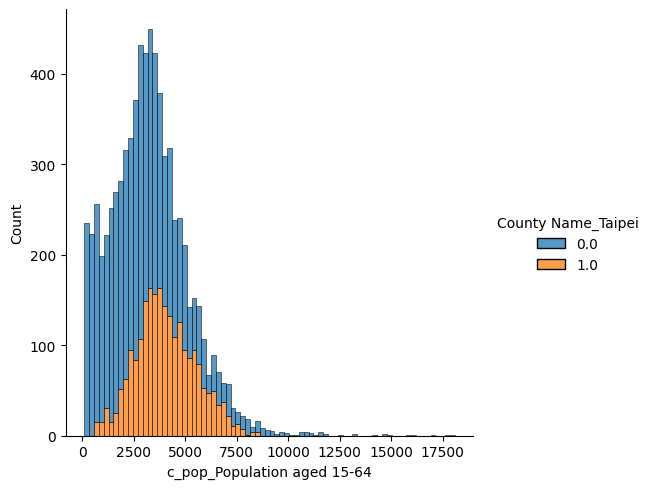

In [ ]:
sns.displot(data=df, x="c_pop_Population aged 15-64", hue="County Name_Taipei", multiple="stack")

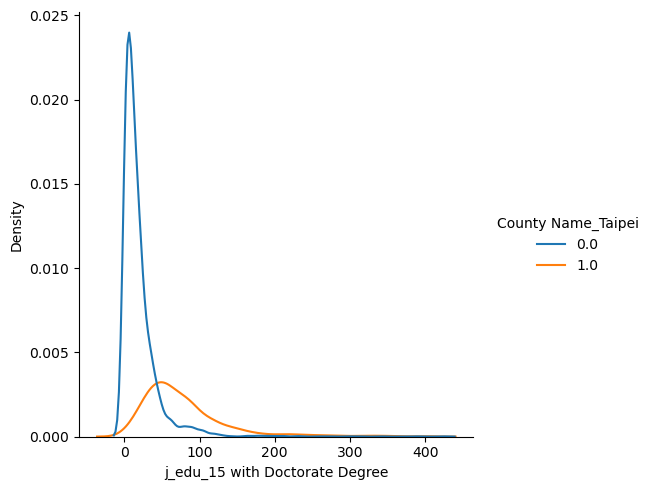

In [6]:
sns.displot(data=df, x="j_edu_15 with Doctorate Degree", hue="County Name_Taipei", kind="kde")

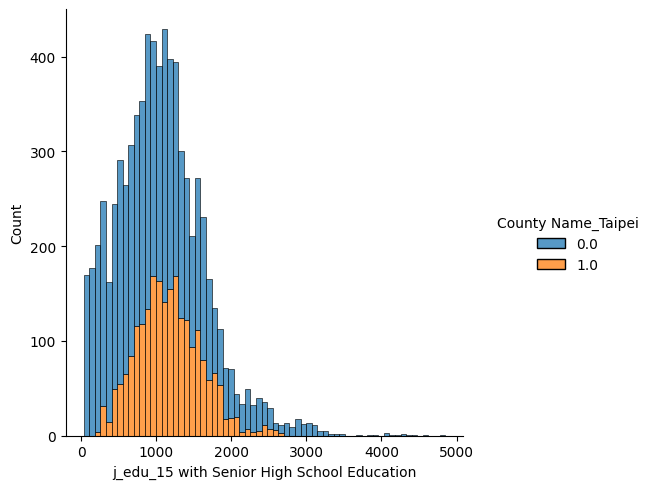

In [ ]:
sns.displot(data=df, x="j_edu_15 with Senior High School Education", hue="County Name_Taipei", multiple="stack")

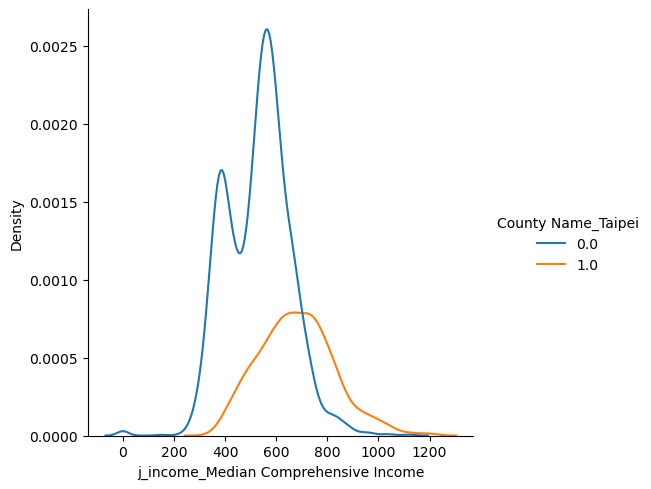

In [5]:
sns.displot(data=df, x="j_income_Median Comprehensive Income", hue="County Name_Taipei", kind="kde")

C:\Users\jigme\anaconda3\lib\site-packages\seaborn\utils.py:95: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  fig.canvas.draw()


C:\Users\jigme\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


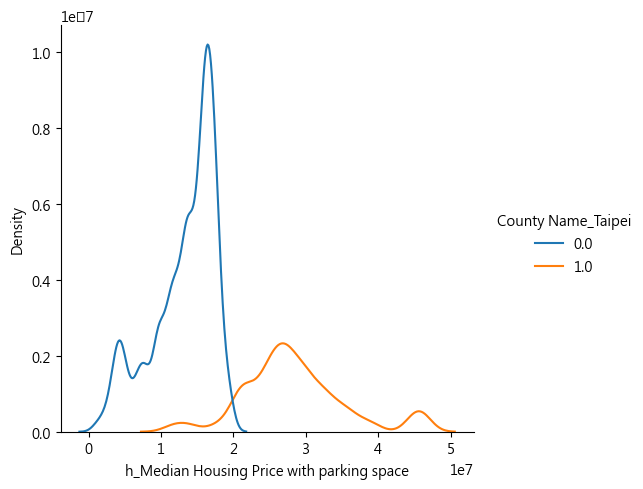

In [35]:
sns.displot(data=df, x="h_Median Housing Price with parking space", hue="County Name_Taipei", kind="kde")

C:\Users\jigme\anaconda3\lib\site-packages\seaborn\distributions.py:316: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  warnings.warn(msg, UserWarning)


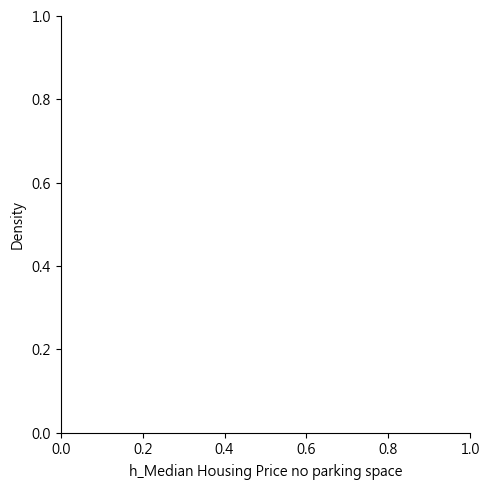

In [34]:
sns.displot(data=df[(df['Township Name']=='中正區') & (df['Year']==107)], x="h_Median Housing Price no parking space", hue="Village Name", kind="kde",legend=False)

C:\Users\jigme\anaconda3\lib\site-packages\seaborn\axisgrid.py:88: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  self._figure.tight_layout(*args, **kwargs)


C:\Users\jigme\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Glyph 8722 (\N{MINUS SIGN}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


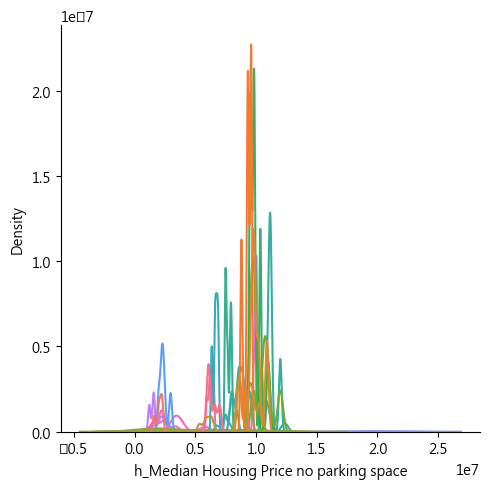

In [17]:
sns.displot(data=df[df['County Name_Taipei']==0], x="h_Median Housing Price no parking space", hue="Township Name", kind="kde",legend=False)

In [4]:
g = sns.PairGrid(df.iloc[:,4:55], diag_sharey=False)
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot)

### Population and marriage

In [17]:
a = df.filter(regex="_pop_|_marrital_")
a['County Name_Taipei'] = df['County Name_Taipei']

C:\Users\jigme\AppData\Local\Temp\ipykernel_38724\213626019.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  a['County Name_Taipei'] = df['County Name_Taipei']


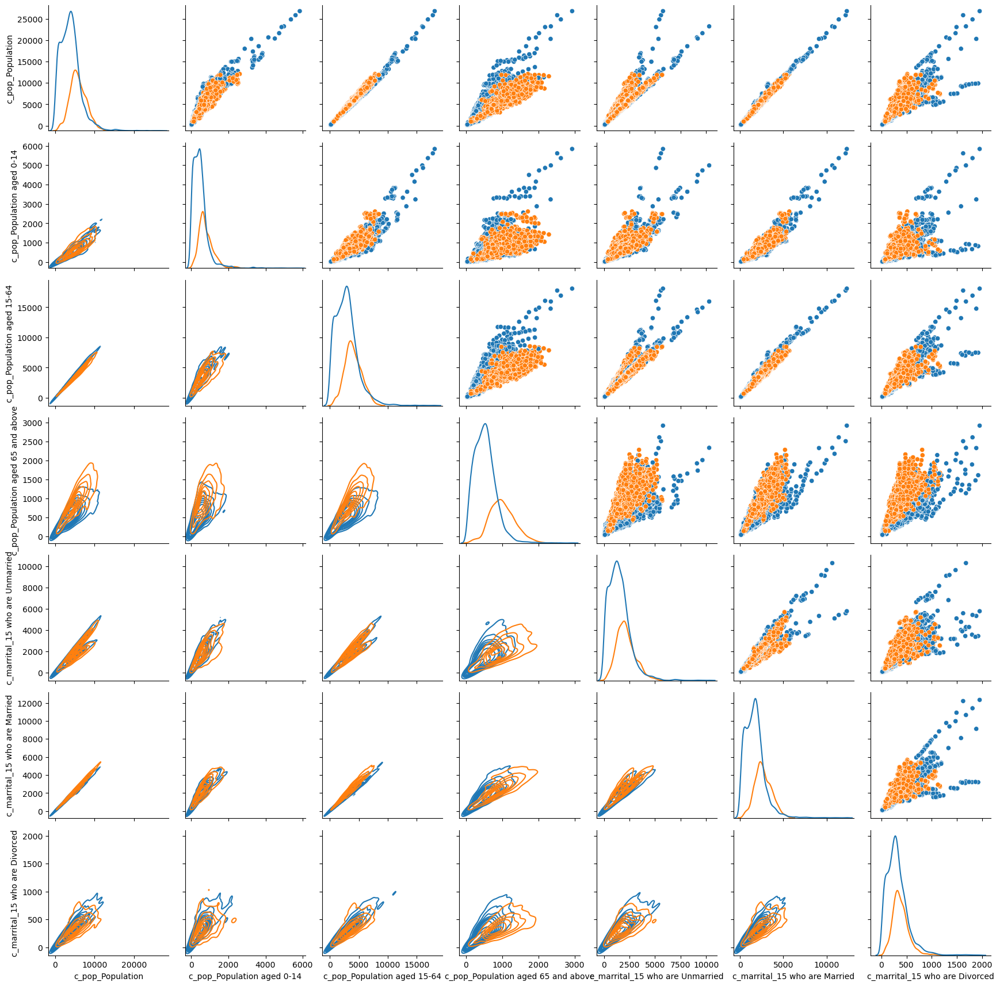

In [18]:
g = sns.PairGrid(a, diag_sharey=False, hue="County Name_Taipei")
g.map_upper(sns.scatterplot)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot)

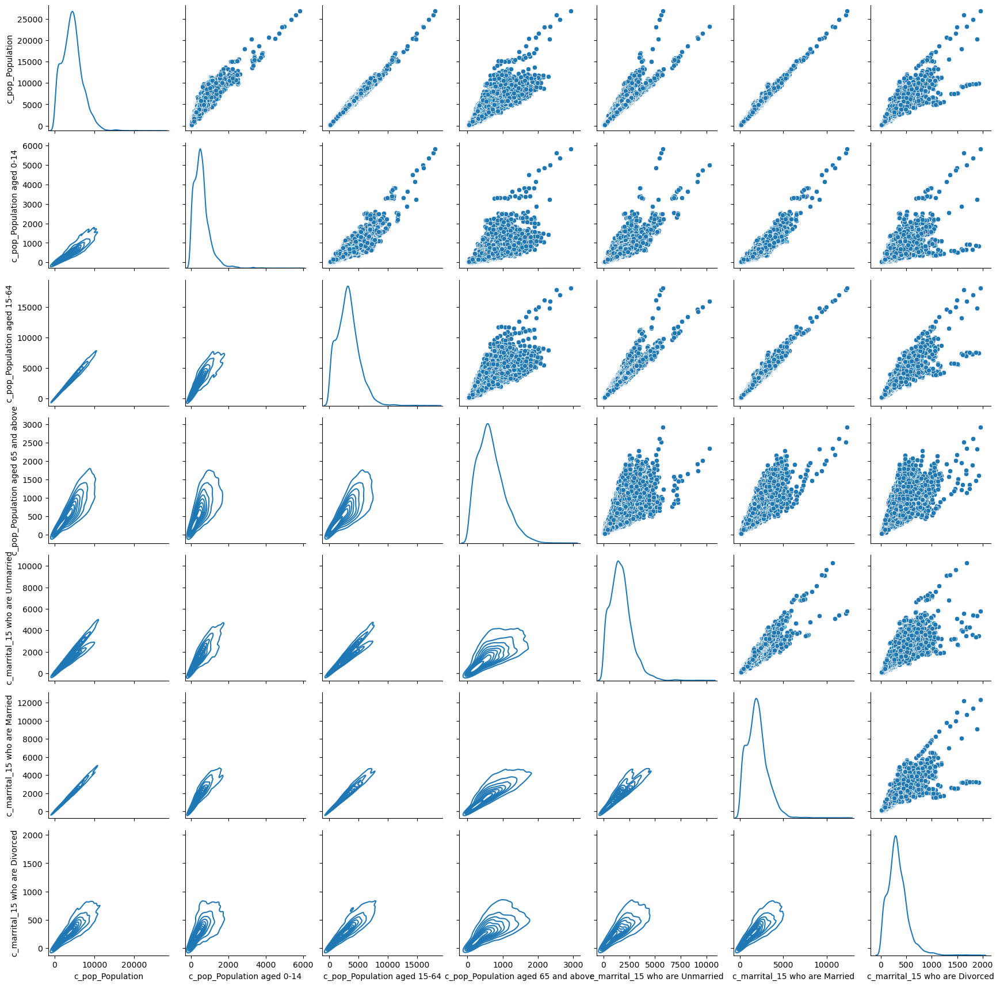

In [9]:
plt.show()

## income

In [19]:
b = df.filter(regex="income")
b.describe()
b['County Name_Taipei']= df['County Name_Taipei']

C:\Users\jigme\AppData\Local\Temp\ipykernel_38724\3129724477.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  b['County Name_Taipei']= df['County Name_Taipei']


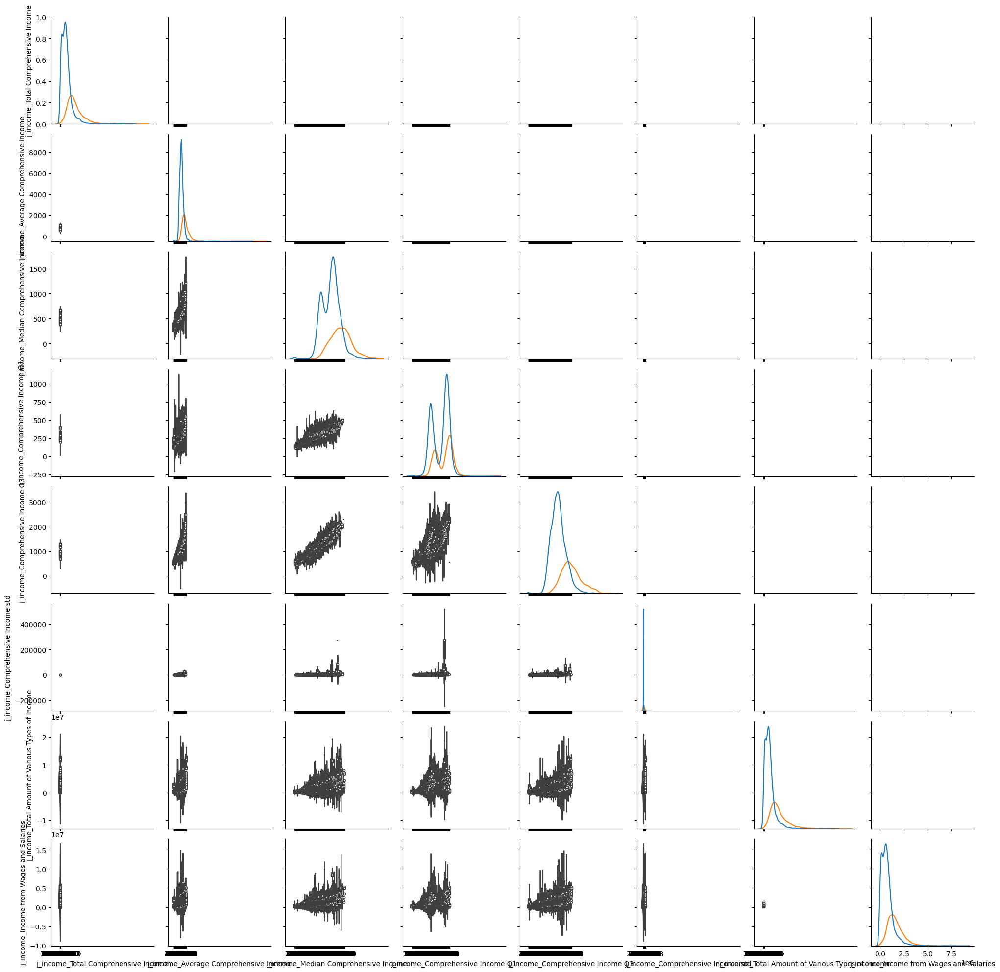

In [20]:
g = sns.PairGrid(b, diag_sharey=False, hue="County Name_Taipei")
#g.map_upper(sns.lmplot)
g.map_lower(sns.violinplot)
g.map_diag(sns.kdeplot)